# German Traffic Sign Recognition Benchmark (GTSRB)
German Traffic Sign Recognition Dataset (GTSRB) is a multi-class, single-image classification image dataset. The images are photographs of traffic signs belonging to 43 distinct classes.</br>
The training set contains 39209 labeled images and the test set contains 12630 images. More about the data [here](https://benchmark.ini.rub.de/).
</br></br>
Classifying traffic sign signals is an application of Convolutional Neural Networks (CNNs).</br>
This concept can be used in autonomous vehicle (AV) industry.

In [ ]:
#Importing all the necessary libraries
from zipfile import ZipFile
import os
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
np.random.seed(42)
import random
random.seed(42)
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPool2D, Dropout, Dense, BatchNormalization, GlobalAveragePooling2D
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import load_model
import pandas as pd

# Importing the dataset directly from Kaggle
Before we start:- <br>
 - Create a Kaggle account; if not already done, go to [Kaggle.com](https://www.kaggle.com/).
 - On your account on Kaggle - top right corner of the page [Profile , **Account**, Sign Out] - Click on account and scroll down to APIs. 
 - Here create a new API token - you should get an option to download a **kaggle.json** file

In [ ]:
#Install kaggle
! pip install -q kaggle

In [ ]:
#Upload the kaggle.json file you just downloaded
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"chaitanyaag","key":"6cb256076ca338548d5e2a1e204faadf"}'}

In [ ]:
#Make directory named kaggle 
!mkdir ~/.kaggle

# copy kaggle.json file there.
! cp kaggle.json ~/.kaggle/

In [ ]:
#change the permissions of the file
! chmod 600 ~/.kaggle/kaggle.json 

- Now go to this [link](https://www.kaggle.com/meowmeowmeowmeowmeow/gtsrb-german-traffic-sign), copy the API command, and run it with "!" in the prefix.

In [ ]:
#Downloading the dataset directly from Kaggle using the API command
!kaggle datasets download -d meowmeowmeowmeowmeow/gtsrb-german-traffic-sign

 97% 595M/612M [00:03<00:00, 156MB/s]
100% 612M/612M [00:03<00:00, 178MB/s]


In [ ]:
#Extracting from Zip file
file_name = "gtsrb-german-traffic-sign.zip"

with ZipFile(file_name, 'r') as zip:
  zip.extractall()

In [ ]:
# Getting the current path
cur_path = os.getcwd()

# Taking a look at Training Images

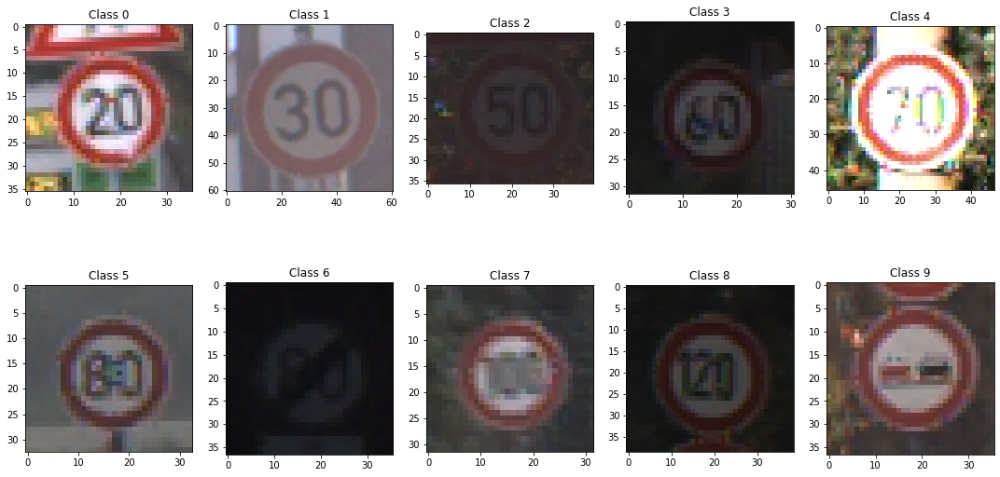

In [ ]:
n= 0 # Don't change the value of n

# Displaying few training images
fig,axis = plt.subplots(2, 5, figsize=(15,15))
for i in range(0,2):
  for j in range(0,5):
    img = plt.imread(os.path.join(cur_path, 'Train', str(n), ('0000' + str(n) + '_00000_00009.png')))
    axis[i,j].imshow(img)
    axis[i,j].set_title('Class '+ str(n))
    n+=1
    fig.tight_layout()
  fig.tight_layout() 

It can be observed that images are of different sizes.

In [ ]:
#Specifying the size of all the images
size = 50

In [ ]:
classes = 43 # We have 43 classes
ntrain = []  # List of number of training images in each class

X = [] # List of training images
Y = [] # List of labels

# Loading the training images and labels in a list
for c in range(classes):
  path = os.path.join(cur_path, 'train', str(c))
  images = os.listdir(path)
  ntrain.append(len(images))
  for i in images:
    image = Image.open(os.path.join(path, i))
    image = image.resize((size, size))
    image = np.array(image)
    X.append(image)
    Y.append(c)

# Converting lists to numpy arrays
X = np.array(X) 
Y = np.array(Y)

In [ ]:
# Splitting the training data into training and validation datasets
x_train, x_val, y_train, y_val = train_test_split(X, Y, test_size = 0.2, random_state = 42)

### Class Biases 

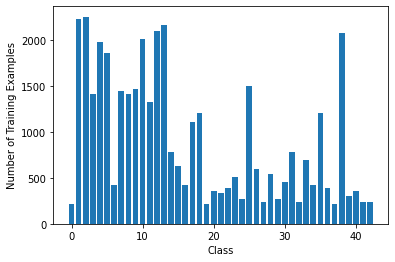

In [ ]:
# Plotting the number of images in each class
plt.bar(range(classes), ntrain, width=0.8)
plt.xlabel('Class')
plt.ylabel('Number of Training Examples')
plt.show()

It can be observed that dataset is highly imbalanced. Different techniques can be employed to deal with this issue.</br>
We are limiting our scope in this notebook by using the data as it is. 

### Callbacks

In [ ]:
# Early stopping whenever the model starts to overfit 
es = EarlyStopping(patience=11, verbose=1, restore_best_weights=True, monitor='val_loss')

# Reducing the learning rate when validation loss doesn't decrease after certain number of epochs
lr = ReduceLROnPlateau(patience=4, factor=0.3, verbose=1)

# MODEL

In [ ]:
# Building a simple Convolutional Neural Network with some regularization techniques
model = Sequential([Conv2D(32, (5, 5), activation = 'relu', input_shape=(size, size, 3), kernel_regularizer='l2'),
                    Conv2D(64, (5, 5), activation = 'relu', kernel_regularizer='l2'),
                    MaxPool2D((2,2)),
                    Dropout(0.35),
                    BatchNormalization(),
                    Dropout(0.3),
                    Conv2D(64, (3, 3), activation = 'relu', kernel_regularizer='l2'),
                    Conv2D(128, (3, 3), activation = 'relu', kernel_regularizer='l2'),
                    MaxPool2D((2,2)),
                    Dropout(0.35),
                    BatchNormalization(),
                    Dropout(0.3),
                    GlobalAveragePooling2D(),
                    Dense(512, activation = 'relu', kernel_regularizer='l2'),
                    Dropout(0.5),
                    BatchNormalization(),
                    Dropout(0.4),
                    Dense(512, activation = 'relu', kernel_regularizer='l2'),
                    Dropout(0.5),
                    BatchNormalization(),
                    Dropout(0.4),
                    Dense(43, activation = 'softmax')])
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 46, 46, 32)        2432      
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 42, 42, 64)        51264     
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 21, 21, 64)        0         
_________________________________________________________________
dropout (Dropout)            (None, 21, 21, 64)        0         
_________________________________________________________________
batch_normalization (BatchNo (None, 21, 21, 64)        256       
_________________________________________________________________
dropout_1 (Dropout)          (None, 21, 21, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 19, 19, 64)        3

In [ ]:
# Compiling the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

## ImageDataGenerator

In [23]:
batch_size=32

# We can use different data augmentations, but for simplicity, we just rescaled the images to normalize the pixel values.
train_datagen = ImageDataGenerator(rescale = 1.0/255)

validation_datagen = val_gen = ImageDataGenerator(rescale = 1.0/255)

train_generator = train_datagen.flow(x_train, y_train, shuffle=True, batch_size = batch_size)

validation_generator = validation_datagen.flow(x_val, y_val, shuffle=True, batch_size = batch_size)

## Training the model

In [17]:
#Upload the .h5 pre-trained model file(s) to avoid re-training --> save time & energy
from google.colab import files
files.upload()

Saving model.h5 to model.h5


{'model.h5': b'\x89HDF\r\n\x1a\n\x00\x00\x00\x00\x00\x08\x08\x00\x04\x00\x10\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\xff\xff\xff\xff\xff\xff\xff\xff\xa0\xb9`\x00\x00\x00\x00\x00\xff\xff\xff\xff\xff\xff\xff\xff\x00\x00\x00\x00\x00\x00\x00\x00`\x00\x00\x00\x00\x00\x00\x00\x01\x00\x00\x00\x00\x00\x00\x00\x88\x00\x00\x00\x00\x00\x00\x00\xa8\x02\x00\x00\x00\x00\x00\x00\x01\x00\x07\x00\x01\x00\x00\x00\x18\x00\x00\x00\x00\x00\x00\x00\x10\x00\x10\x00\x00\x00\x00\x00 \x03\x00\x00\x00\x00\x00\x00h\x01\x00\x00\x00\x00\x00\x00TREE\x00\x00\x01\x00\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\x00\x00\x00\x00\x00\x00\x00\x00\x00H\x00\x00\x00\x00\x00\x00\x18\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x0

In [ ]:
history = model.fit(train_generator,
                    validation_data = validation_generator,
                    epochs=500,
                    verbose=2,
                    steps_per_epoch= train_generator.__len__(),
                    validation_steps = validation_generator.__len__(),
                    callbacks=[es,lr])

Epoch 1/500
981/981 - 13s - loss: 7.1507 - accuracy: 0.1396 - val_loss: 4.3103 - val_accuracy: 0.1926
Epoch 2/500
981/981 - 9s - loss: 2.9980 - accuracy: 0.3939 - val_loss: 2.7722 - val_accuracy: 0.4806
Epoch 3/500
981/981 - 9s - loss: 2.2706 - accuracy: 0.6405 - val_loss: 1.7817 - val_accuracy: 0.8180
Epoch 4/500
981/981 - 9s - loss: 2.0411 - accuracy: 0.7360 - val_loss: 1.8282 - val_accuracy: 0.8245
Epoch 5/500
981/981 - 9s - loss: 1.9959 - accuracy: 0.7766 - val_loss: 1.5751 - val_accuracy: 0.9081
Epoch 6/500
981/981 - 9s - loss: 1.9598 - accuracy: 0.7963 - val_loss: 1.4226 - val_accuracy: 0.9411
Epoch 7/500
981/981 - 9s - loss: 1.9358 - accuracy: 0.8064 - val_loss: 1.4719 - val_accuracy: 0.9392
Epoch 8/500
981/981 - 9s - loss: 1.9315 - accuracy: 0.8148 - val_loss: 1.6022 - val_accuracy: 0.9137
Epoch 9/500
981/981 - 9s - loss: 1.8402 - accuracy: 0.8307 - val_loss: 1.5957 - val_accuracy: 0.9216
Epoch 10/500
981/981 - 9s - loss: 1.8739 - accuracy: 0.8295 - val_loss: 1.4053 - val_accur

In [ ]:
# The model took around 40 minutes to train on GPU hence, saving the model for future use.
model.save("model.h5")

In [18]:
# Loading the pre-trained model to save time and energy!
model = load_model('/content/model.h5') # make sure the path of the model is correct

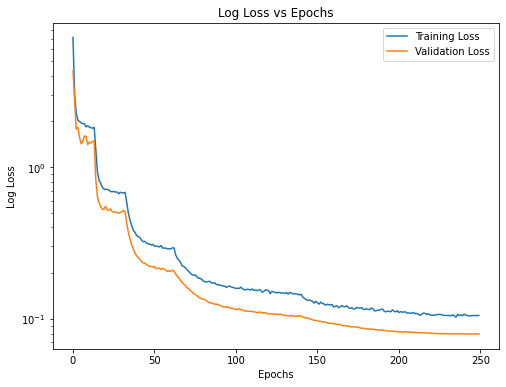

In [ ]:
# Plotting Log Loss vs Number of Epochs
plt.figure(figsize=(8,6))
plt.semilogy(history.history['loss'], label='Training Loss')
plt.semilogy(history.history['val_loss'], label='Validation Loss')
plt.title('Log Loss vs Epochs')
plt.xlabel('Epochs')
plt.ylabel('Log Loss')
plt.legend()
plt.show()

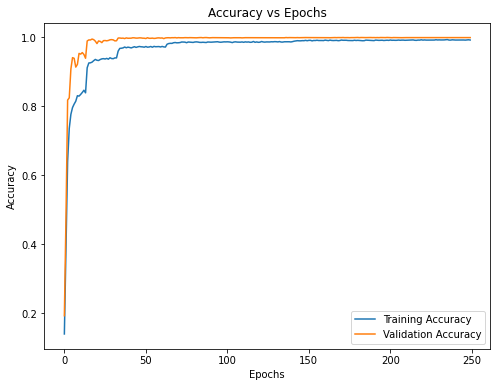

In [ ]:
# Plotting Accuracy vs Number of Epochs
plt.figure(figsize=(8,6))
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy vs Epochs')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

# Testing on test dataset

In [19]:
# Loading the test dataset CSV and having a look at the same
df = pd.read_csv('/content/Test.csv')
df.head()

,Width,Height,Roi.X1,Roi.Y1,Roi.X2,Roi.Y2,ClassId,Path
0,53,54,6,5,48,49,16,Test/00000.png
1,42,45,5,5,36,40,1,Test/00001.png
2,48,52,6,6,43,47,38,Test/00002.png
3,27,29,5,5,22,24,33,Test/00003.png
4,60,57,5,5,55,52,11,Test/00004.png


In [20]:
# Extracting the labels from CSV file and converting the pandas dataframe to numpy array
y_test = df['ClassId'].to_numpy()
print(y_test.shape)

(12630,)


In [21]:
# Loading the test images in a list
x_test = []
test_path = os.path.join(cur_path, 'test')

for file in sorted(os.listdir(test_path)):
  try:
    test_image = Image.open(os.path.join(test_path,file))
    test_image = test_image.resize((size, size))
    test_image = np.array(test_image)
    test_image = test_image/255.0
    x_test.append(test_image)
  except:
    continue

# Converting the list to numpy array
x_test = np.array(x_test)
print(x_test.shape) 

(12630, 50, 50, 3)


In [24]:
# Evaluating the model on test dataset
y_pred = model.evaluate(x=x_test, y=y_test, batch_size=batch_size)

395/395 [==============================] - 9s 4ms/step - loss: 0.1493 - accuracy: 0.9808
